*PART A*

In [129]:
import numpy as np
import pandas as pd 
import seaborn as sns 
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import urllib
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn.metrics import confusion_matrix, classification_report

%matplotlib inline

In [130]:
urllib.request.urlretrieve("https://upload.wikimedia.org/wikipedia/commons/9/9f/Iris_virginica.jpg", "vg_iris.jpg")
urllib.request.urlretrieve("https://upload.wikimedia.org/wikipedia/commons/4/41/Iris_versicolor_3.jpg", "versi_iris.jpg")
urllib.request.urlretrieve("https://upload.wikimedia.org/wikipedia/commons/5/56/Kosaciec_szczecinkowaty_Iris_setosa.jpg", "seto_iris.jpg")

('seto_iris.jpg', <http.client.HTTPMessage at 0x274391b7df0>)

In [131]:
plt.figure(figsize=(300, 300))
img = mpimg.imread('vg_iris.jpg')
imgplot = plt.imshow(img)
plt.show()

In [132]:
plt.figure(figsize=(300, 300))
img = mpimg.imread('versi_iris.jpg')
imgplot = plt.imshow(img)
plt.show()

In [133]:
plt.figure(figsize=(300, 300))
img = mpimg.imread('seto_iris.jpg')
imgplot = plt.imshow(img)
plt.show()

In [134]:
iris = sns.load_dataset('iris')
df = pd.DataFrame(iris)
df.head(5)

,sepal_length,sepal_width,petal_length,petal_width,species
0,5.1,3.5,1.4,0.2,setosa
1,4.9,3.0,1.4,0.2,setosa
2,4.7,3.2,1.3,0.2,setosa
3,4.6,3.1,1.5,0.2,setosa
4,5.0,3.6,1.4,0.2,setosa


In [135]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150 entries, 0 to 149
Data columns (total 5 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   sepal_length  150 non-null    float64
 1   sepal_width   150 non-null    float64
 2   petal_length  150 non-null    float64
 3   petal_width   150 non-null    float64
 4   species       150 non-null    object 
dtypes: float64(4), object(1)
memory usage: 6.0+ KB


In [136]:
df.describe()

,sepal_length,sepal_width,petal_length,petal_width
count,150.000000,150.000000,150.000000,150.000000
mean,5.843333,3.057333,3.758000,1.199333
std,0.828066,0.435866,1.765298,0.762238
min,4.300000,2.000000,1.000000,0.100000
25%,5.100000,2.800000,1.600000,0.300000
50%,5.800000,3.000000,4.350000,1.300000
75%,6.400000,3.300000,5.100000,1.800000
max,7.900000,4.400000,6.900000,2.500000


In [137]:
df.isnull().sum()

sepal_length    0
sepal_width     0
petal_length    0
petal_width     0
species         0
dtype: int64

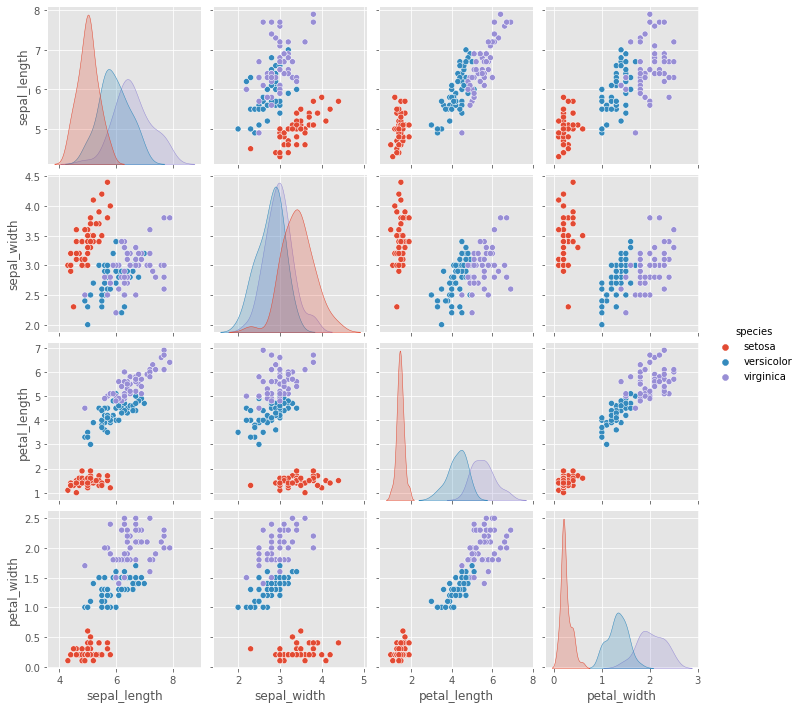

In [138]:
sns.pairplot(iris, hue='species')

C:\Users\Slims\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\Slims\anaconda3\lib\site-packages\seaborn\distributions.py:1718: UserWarning: `shade_lowest` is now deprecated in favor of `thresh`. Setting `thresh=0.05`, but please update your code.
  warnings.warn(msg, UserWarning)


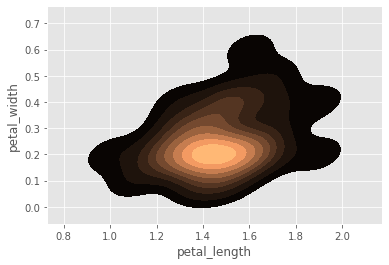

In [139]:
setosa = df.loc[df.species=="setosa"]
analysis = sns.kdeplot(setosa.petal_length, setosa.petal_width,cmap='copper', shade=True, shade_lowest=False)
plt.show()

Text(0.5, 1.0, 'Correlation On iris Classes')

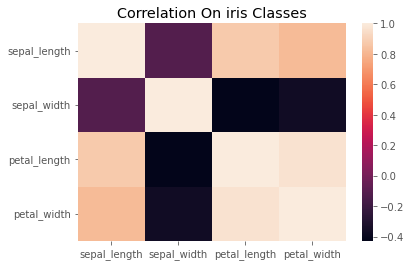

In [140]:
sns.heatmap(df.corr(), cmap="rocket")
plt.title('Correlation On iris Classes')

In [141]:
X_features = df.iloc[:, 0:4]
Y_dependant = df.iloc[:,-1]

In [142]:
X_train, X_test, y_train, y_test = train_test_split(X_features, Y_dependant, test_size=0.3, random_state=42)

In [143]:
clf = SVC()
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)

In [144]:
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[19  0  0]
 [ 0 13  0]
 [ 0  0 13]]
              precision    recall  f1-score   support

      setosa       1.00      1.00      1.00        19
  versicolor       1.00      1.00      1.00        13
   virginica       1.00      1.00      1.00        13

    accuracy                           1.00        45
   macro avg       1.00      1.00      1.00        45
weighted avg       1.00      1.00      1.00        45



In [145]:
from sklearn.model_selection import GridSearchCV
param_grid = {'C': [0.1, 1, 10, 100, 1000], 
              'gamma': [1, 0.1, 0.01, 0.001, 0.0001],
              'kernel': ['rbf']} 
grid = GridSearchCV(SVC(),param_grid,refit = True, verbose = 3)
grid.fit(X_train, y_train)

Fitting 5 folds for each of 25 candidates, totalling 125 fits
[CV 1/5] END ........C=0.1, gamma=1, kernel=rbf;, score=1.000 total time=   0.0s
[CV 2/5] END ........C=0.1, gamma=1, kernel=rbf;, score=0.905 total time=   0.0s
[CV 3/5] END ........C=0.1, gamma=1, kernel=rbf;, score=0.905 total time=   0.0s
[CV 4/5] END ........C=0.1, gamma=1, kernel=rbf;, score=1.000 total time=   0.0s
[CV 5/5] END ........C=0.1, gamma=1, kernel=rbf;, score=0.905 total time=   0.0s
[CV 1/5] END ......C=0.1, gamma=0.1, kernel=rbf;, score=1.000 total time=   0.0s
[CV 2/5] END ......C=0.1, gamma=0.1, kernel=rbf;, score=0.857 total time=   0.0s
[CV 3/5] END ......C=0.1, gamma=0.1, kernel=rbf;, score=0.810 total time=   0.0s
[CV 4/5] END ......C=0.1, gamma=0.1, kernel=rbf;, score=1.000 total time=   0.0s
[CV 5/5] END ......C=0.1, gamma=0.1, kernel=rbf;, score=0.857 total time=   0.0s
[CV 1/5] END .....C=0.1, gamma=0.01, kernel=rbf;, score=0.524 total time=   0.0s
[CV 2/5] END .....C=0.1, gamma=0.01, kernel=rbf

[CV 2/5] END ....C=1000, gamma=0.01, kernel=rbf;, score=0.905 total time=   0.0s
[CV 3/5] END ....C=1000, gamma=0.01, kernel=rbf;, score=0.905 total time=   0.0s
[CV 4/5] END ....C=1000, gamma=0.01, kernel=rbf;, score=1.000 total time=   0.0s
[CV 5/5] END ....C=1000, gamma=0.01, kernel=rbf;, score=1.000 total time=   0.0s
[CV 1/5] END ...C=1000, gamma=0.001, kernel=rbf;, score=1.000 total time=   0.0s
[CV 2/5] END ...C=1000, gamma=0.001, kernel=rbf;, score=0.952 total time=   0.0s
[CV 3/5] END ...C=1000, gamma=0.001, kernel=rbf;, score=0.905 total time=   0.0s
[CV 4/5] END ...C=1000, gamma=0.001, kernel=rbf;, score=1.000 total time=   0.0s
[CV 5/5] END ...C=1000, gamma=0.001, kernel=rbf;, score=1.000 total time=   0.0s
[CV 1/5] END ..C=1000, gamma=0.0001, kernel=rbf;, score=1.000 total time=   0.0s
[CV 2/5] END ..C=1000, gamma=0.0001, kernel=rbf;, score=0.905 total time=   0.0s
[CV 3/5] END ..C=1000, gamma=0.0001, kernel=rbf;, score=0.905 total time=   0.0s
[CV 4/5] END ..C=1000, gamma

GridSearchCV(estimator=SVC(),
             param_grid={'C': [0.1, 1, 10, 100, 1000],
                         'gamma': [1, 0.1, 0.01, 0.001, 0.0001],
                         'kernel': ['rbf']},
             verbose=3)

In [146]:
print(grid.best_params_)
print(grid.best_estimator_)

{'C': 100, 'gamma': 0.01, 'kernel': 'rbf'}
SVC(C=100, gamma=0.01)


In [147]:
new_pred = grid.predict(X_test)

In [148]:
print(classification_report(y_test, new_pred))

              precision    recall  f1-score   support

      setosa       1.00      1.00      1.00        19
  versicolor       1.00      1.00      1.00        13
   virginica       1.00      1.00      1.00        13

    accuracy                           1.00        45
   macro avg       1.00      1.00      1.00        45
weighted avg       1.00      1.00      1.00        45



*PART B*

In [149]:
dt = pd.read_csv("KNN_Project_Data")
knn_df = pd.DataFrame(dt)

In [150]:
display(knn_df.head(5))

,XVPM,GWYH,TRAT,TLLZ,IGGA,HYKR,EDFS,GUUB,MGJM,JHZC,TARGET CLASS
0,1636.670614,817.988525,2565.995189,358.347163,550.417491,1618.870897,2147.641254,330.727893,1494.878631,845.136088,0
1,1013.402760,577.587332,2644.141273,280.428203,1161.873391,2084.107872,853.404981,447.157619,1193.032521,861.081809,1
2,1300.035501,820.518697,2025.854469,525.562292,922.206261,2552.355407,818.676686,845.491492,1968.367513,1647.186291,1
3,1059.347542,1066.866418,612.000041,480.827789,419.467495,685.666983,852.867810,341.664784,1154.391368,1450.935357,0
4,1018.340526,1313.679056,950.622661,724.742174,843.065903,1370.554164,905.469453,658.118202,539.459350,1899.850792,0


In [151]:
knn_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 11 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   XVPM          1000 non-null   float64
 1   GWYH          1000 non-null   float64
 2   TRAT          1000 non-null   float64
 3   TLLZ          1000 non-null   float64
 4   IGGA          1000 non-null   float64
 5   HYKR          1000 non-null   float64
 6   EDFS          1000 non-null   float64
 7   GUUB          1000 non-null   float64
 8   MGJM          1000 non-null   float64
 9   JHZC          1000 non-null   float64
 10  TARGET CLASS  1000 non-null   int64  
dtypes: float64(10), int64(1)
memory usage: 86.1 KB


In [152]:
knn_df.describe()

,XVPM,GWYH,TRAT,TLLZ,IGGA,HYKR,EDFS,GUUB,MGJM,JHZC,TARGET CLASS
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.00000
mean,1055.071157,991.851567,1529.373525,495.107156,940.590072,1550.637455,1561.003252,561.346117,1089.067338,1452.521629,0.50000
std,370.980193,392.278890,640.286092,142.789188,345.923136,493.491988,598.608517,247.357552,402.666953,568.132005,0.50025
min,21.170000,21.720000,31.800000,8.450000,17.930000,27.930000,31.960000,13.520000,23.210000,30.890000,0.00000
25%,767.413366,694.859326,1062.600806,401.788135,700.763295,1219.267077,1132.097865,381.704293,801.849802,1059.499689,0.00000
50%,1045.904805,978.355081,1522.507269,500.197421,939.348662,1564.996551,1565.882879,540.420379,1099.087954,1441.554053,0.50000
75%,1326.065178,1275.528770,1991.128626,600.525709,1182.578166,1891.937040,1981.739411,725.762027,1369.923665,1864.405512,1.00000
max,2117.000000,2172.000000,3180.000000,845.000000,1793.000000,2793.000000,3196.000000,1352.000000,2321.000000,3089.000000,1.00000


In [153]:
knn_df.isnull().sum()

XVPM            0
GWYH            0
TRAT            0
TLLZ            0
IGGA            0
HYKR            0
EDFS            0
GUUB            0
MGJM            0
JHZC            0
TARGET CLASS    0
dtype: int64

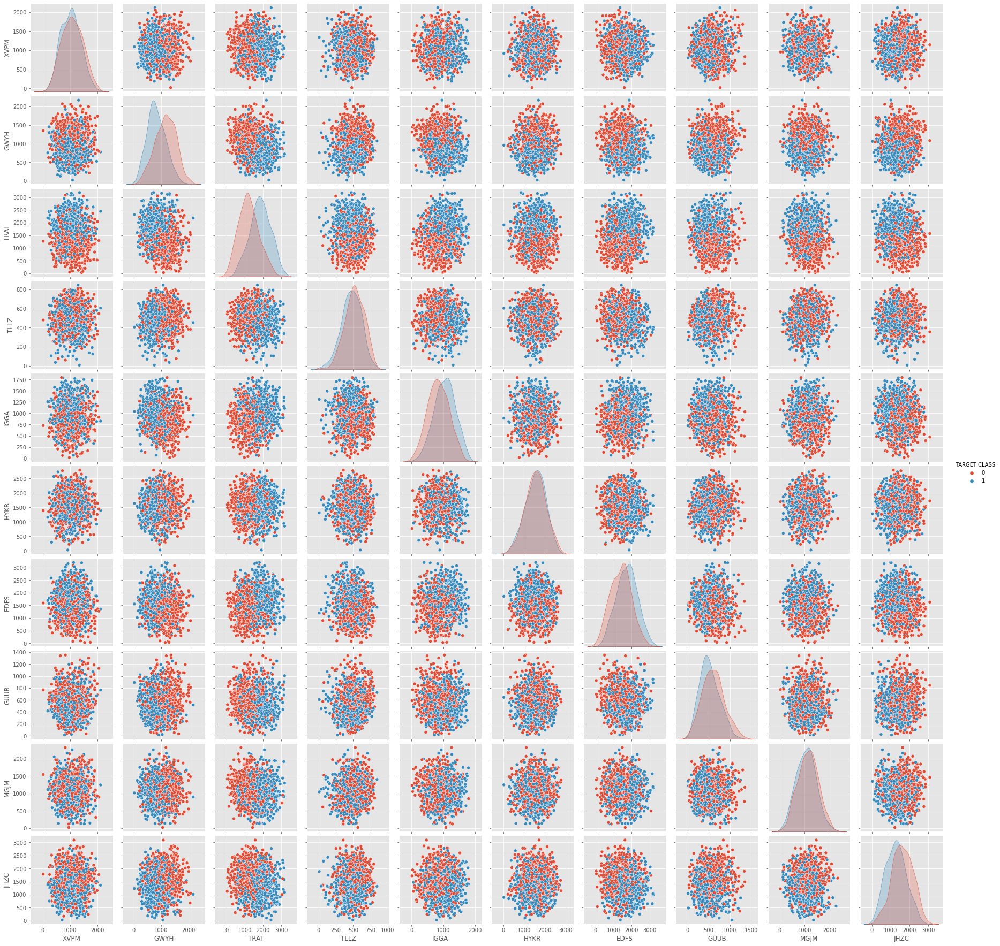

In [154]:
sns.pairplot(knn_df, hue='TARGET CLASS')

Text(0.5, 1.0, 'Correlation')

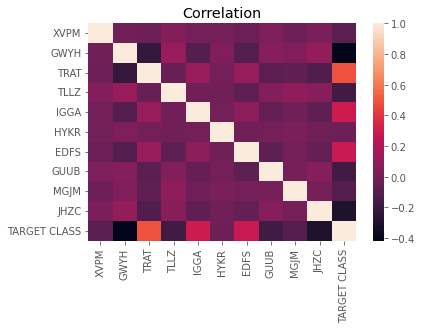

In [155]:
sns.heatmap(knn_df.corr(), cmap="rocket")
plt.title('Correlation')

In [156]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(X = knn_df.drop('TARGET CLASS', axis = 1))
sc = scaler.transform(X = knn_df.drop('TARGET CLASS', axis = 1))

In [157]:
print(sc)

[[ 1.56852168 -0.44343461  1.61980773 ... -0.93279392  1.00831307
  -1.06962723]
 [-0.11237594 -1.05657361  1.7419175  ... -0.46186435  0.25832069
  -1.04154625]
 [ 0.66064691 -0.43698145  0.77579285 ...  1.14929806  2.1847836
   0.34281129]
 ...
 [-0.35889496 -0.97901454  0.83771499 ... -1.51472604 -0.27512225
   0.86428656]
 [ 0.27507999 -0.99239881  0.0303711  ... -0.03623294  0.43668516
  -0.21245586]
 [ 0.62589594  0.79510909  1.12180047 ... -1.25156478 -0.60352946
  -0.87985868]]


In [158]:
df_sc = pd.DataFrame(sc, columns=knn_df.columns[:-1])
df_sc.head()

,XVPM,GWYH,TRAT,TLLZ,IGGA,HYKR,EDFS,GUUB,MGJM,JHZC
0,1.568522,-0.443435,1.619808,-0.958255,-1.128481,0.138336,0.980493,-0.932794,1.008313,-1.069627
1,-0.112376,-1.056574,1.741918,-1.504220,0.640009,1.081552,-1.182663,-0.461864,0.258321,-1.041546
2,0.660647,-0.436981,0.775793,0.213394,-0.053171,2.030872,-1.240707,1.149298,2.184784,0.342811
3,0.011533,0.191324,-1.433473,-0.100053,-1.507223,-1.753632,-1.183561,-0.888557,0.162310,-0.002793
4,-0.099059,0.820815,-0.904346,1.609015,-0.282065,-0.365099,-1.095644,0.391419,-1.365603,0.787762


In [159]:
X_features = df_sc.iloc[:,:]
Y_features = knn_df.iloc[:,-1]

In [160]:
X_train, X_test, Y_train, Y_test = train_test_split(X_features, Y_features, test_size = 0.3)

In [161]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors = 1)
knn.fit(X_train, Y_train)

KNeighborsClassifier(n_neighbors=1)

In [162]:
k_pred = knn.predict(X_test)

In [163]:
print(confusion_matrix(Y_test,k_pred))
print(classification_report(Y_test,k_pred))

[[106  36]
 [ 47 111]]
              precision    recall  f1-score   support

           0       0.69      0.75      0.72       142
           1       0.76      0.70      0.73       158

    accuracy                           0.72       300
   macro avg       0.72      0.72      0.72       300
weighted avg       0.73      0.72      0.72       300



In [164]:
error_list = []
for n in range(1,40):
    knn = KNeighborsClassifier(n_neighbors = n)
    knn.fit(X_train, Y_train)
    new_pred = knn.predict(X_test)
    error_list.append(np.mean(new_pred != Y_test))

Text(0.5, 1.0, 'Error Rate vs. K value')

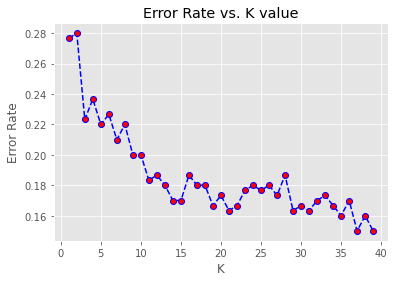

In [165]:
plt.style.use('ggplot') 
plt.plot(range(1,40), error_list, linestyle = 'dashed', color = 'blue', marker = 'o', markerfacecolor = 'red')
plt.xlabel('K')
plt.ylabel('Error Rate')
plt.title('Error Rate vs. K value')

In [167]:
knn = KNeighborsClassifier(n_neighbors = 21)
knn.fit(X_train,Y_train)
k_pred = knn.predict(X_test)
print(confusion_matrix(Y_test,k_pred))
print(classification_report(Y_test,k_pred))

[[121  21]
 [ 28 130]]
              precision    recall  f1-score   support

           0       0.81      0.85      0.83       142
           1       0.86      0.82      0.84       158

    accuracy                           0.84       300
   macro avg       0.84      0.84      0.84       300
weighted avg       0.84      0.84      0.84       300

